# WiDS Datathon 2022
<img src="logos.png" style="height: 200px;" align="center"/>

Organizers: Weiwei Pan (Harvard), Anastasiya Belyaeva (Google), and Arushi Jain (Microsoft).

Datathon: https://www.kaggle.com/c/widsdatathon2022

Datathon task: predict building energy consumption from building characteristics, climate, and weather variables

## Goals:
* Exploratory data analysis
* Data pre-processing (encoding categorical variables, scaling, imputation)
* Fitting a model

## Load necessary libraries

In [ ]:
# Load all the necessary libraries
import numpy as np  # numerical computation with arrays
import pandas as pd # library to manipulate datasets using dataframes
import scipy as sp  # statistical library

# Load sklearn libraries for machine learning
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

# Load plotting libraries
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

# Library to supress warnings or deprecation notes 
import warnings
warnings.filterwarnings('ignore')

## Install and load any additional libraries

In [ ]:
# # This is how you can install any non-standard libraries if needed (uncomment line below).
# !pip install pandas_profiling

# Exploratory data analysis

* Use [Pandas](https://pandas.pydata.org/docs/) package to read and display data
* Explore the columns of the dataset (e.g. target and features)
* Explore patterns and trends in the data through data visualization

## Load the data

In [ ]:
# Load the dataset using pandas
df = pd.read_csv("train.csv.zip")
# Set column 'id' as the index of rows
df = df.set_index('id')

df_test = pd.read_csv("test.csv.zip")
# Set column 'id' as the index of rows
df_test = df_test.set_index('id')

In [ ]:
# Print first couple of rows of the dataset
df.head()

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,...,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui
id,,,,,,,,,,,,,,,,,,,,,
0,1,State_1,Commercial,Grocery_store_or_food_market,61242.0,1942.0,11.0,2.4,36,50.5,...,0,14,0,0,0,1.0,1.0,1.0,NaN,248.682615
1,1,State_1,Commercial,Warehouse_Distribution_or_Shipping_center,274000.0,1955.0,45.0,1.8,36,50.5,...,0,14,0,0,0,1.0,NaN,1.0,12.0,26.500150
2,1,State_1,Commercial,Retail_Enclosed_mall,280025.0,1951.0,97.0,1.8,36,50.5,...,0,14,0,0,0,1.0,NaN,1.0,12.0,24.693619
3,1,State_1,Commercial,Education_Other_classroom,55325.0,1980.0,46.0,1.8,36,50.5,...,0,14,0,0,0,1.0,NaN,1.0,12.0,48.406926
4,1,State_1,Commercial,Warehouse_Nonrefrigerated,66000.0,1985.0,100.0,2.4,36,50.5,...,0,14,0,0,0,1.0,1.0,1.0,NaN,3.899395


## Compute basic properties of the dataset

In [ ]:
# How many rows and columns are in the dataset
df.shape

(75757, 63)

In [ ]:
df_test.shape

(9705, 62)

In [ ]:
# Print a summary statistics for each column in the dataset
df.describe()

,Year_Factor,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,...,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui
count,75757.000000,7.575700e+04,73920.000000,49048.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,...,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,34675.000000,33946.000000,34675.000000,29961.000000,75757.000000
mean,4.367755,1.659839e+05,1952.306764,61.048605,39.506323,11.432343,34.310468,59.054952,11.720567,35.526837,...,0.876764,82.709809,14.058701,0.279539,0.002442,66.552675,62.779974,4.190601,109.142051,82.584693
std,1.471441,2.468758e+05,37.053619,28.663683,60.656596,9.381027,6.996108,5.355458,12.577272,8.866697,...,2.894244,25.282913,10.943996,2.252323,0.142140,131.147834,130.308106,6.458789,50.699751,58.255403
min,1.000000,9.430000e+02,0.000000,0.000000,-6.400000,-19.000000,10.806452,42.000000,-13.000000,13.250000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,12.000000,1.001169
25%,3.000000,6.237900e+04,1927.000000,40.000000,11.900000,6.000000,29.827586,56.000000,2.000000,31.625000,...,0.000000,72.000000,6.000000,0.000000,0.000000,1.000000,1.000000,1.000000,88.000000,54.528601
50%,5.000000,9.136700e+04,1951.000000,67.000000,25.000000,11.000000,34.451613,59.000000,9.000000,34.107143,...,0.000000,84.000000,12.000000,0.000000,0.000000,1.000000,1.000000,1.000000,104.000000,75.293716
75%,6.000000,1.660000e+05,1977.000000,85.000000,42.700000,13.000000,37.322581,62.000000,20.000000,40.879310,...,0.000000,97.000000,17.000000,0.000000,0.000000,1.000000,1.000000,1.000000,131.000000,97.277534
max,6.000000,6.385382e+06,2015.000000,100.000000,1924.500000,49.000000,64.758065,91.000000,48.000000,65.107143,...,31.000000,260.000000,185.000000,119.000000,16.000000,360.000000,360.000000,23.300000,311.000000,997.866120


In [ ]:
# Get information on each column in the dataset
# The 'Non-Null Count' counts the number of values in each column that is not missing
# Dtype indicates the variable type (e.g. integer, float, object)
# Here we see that some columns have missing values, so we have to do imputation
df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 75757 entries, 0 to 75756
Data columns (total 63 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Year_Factor                75757 non-null  int64  
 1   State_Factor               75757 non-null  object 
 2   building_class             75757 non-null  object 
 3   facility_type              75757 non-null  object 
 4   floor_area                 75757 non-null  float64
 5   year_built                 73920 non-null  float64
 6   energy_star_rating         49048 non-null  float64
 7   ELEVATION                  75757 non-null  float64
 8   january_min_temp           75757 non-null  int64  
 9   january_avg_temp           75757 non-null  float64
 10  january_max_temp           75757 non-null  int64  
 11  february_min_temp          75757 non-null  int64  
 12  february_avg_temp          75757 non-null  float64
 13  february_max_temp          75757 non-null  int

### Missing Values

In [ ]:
#Missing Values Train dataset

missing_columns = [col for col in df.columns if df[col].isnull().any()]
missig_values_count = df.isna().sum()
missing_Values_df = pd.DataFrame(missig_values_count.rename("Null Values Count").loc[missig_values_count.ne(0)])
missing_Values_df['Share of Missing Values'] = missing_Values_df["Null Values Count"]/len(df)
missing_Values_df.style.background_gradient(cmap='Pastel1')

,Null Values Count,Share of Missing Values
year_built,1837,0.024249
energy_star_rating,26709,0.352561
direction_max_wind_speed,41082,0.542287
direction_peak_wind_speed,41811,0.551909
max_wind_speed,41082,0.542287
days_with_fog,45796,0.604512


In [ ]:
#Missing Values Test dataset

missing_columns = [col for col in df_test.columns if df_test[col].isnull().any()]
missig_values_count = df_test.isna().sum()
missing_Values_df = pd.DataFrame(missig_values_count.rename("Null Values Count").loc[missig_values_count.ne(0)])
missing_Values_df['Share of Missing Values'] = missing_Values_df["Null Values Count"]/len(df_test)
missing_Values_df.style.background_gradient(cmap='Pastel1')

,Null Values Count,Share of Missing Values
year_built,92,0.009480
energy_star_rating,2254,0.232251
direction_max_wind_speed,8575,0.883565
direction_peak_wind_speed,8575,0.883565
max_wind_speed,8575,0.883565
days_with_fog,9117,0.939413


### Numerical/Categorical Values

In [ ]:
# Split Categorical/Numerical Columns

categorical_features = ['State_Factor', 'building_class', 'facility_type']

numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
NUMERIC_FEATURE_NAMES = df.select_dtypes(include=numerics)

TARGET_FEATURE_NAME = "site_eui"

### Unique Values

In [ ]:
#Count UNIQUE VALUES
df_unique = df.nunique().to_frame().reset_index()
df_unique.columns = ['Variable','DistinctCount']
df_unique

,Variable,DistinctCount
0,Year_Factor,6
1,State_Factor,7
2,building_class,2
3,facility_type,60
4,floor_area,20433
...,...,...
58,direction_max_wind_speed,10
59,direction_peak_wind_speed,8
60,max_wind_speed,16
61,days_with_fog,42


In [ ]:
# Printing the count of each unique value in each column

for column in categorical_features:
    print(df[column].value_counts(normalize=True))
    print("-" * 40)

State_6     0.671093
State_11    0.084639
State_1     0.074158
State_2     0.064298
State_4     0.056760
State_8     0.048854
State_10    0.000198
Name: State_Factor, dtype: float64
----------------------------------------
Residential    0.57497
Commercial     0.42503
Name: building_class, dtype: float64
----------------------------------------
Multifamily_Uncategorized                    0.520810
Office_Uncategorized                         0.165160
Education_Other_classroom                    0.050952
Lodging_Hotel                                0.027694
2to4_Unit_Building                           0.024988
Commercial_Other                             0.023021
5plus_Unit_Building                          0.016804
Warehouse_Nonrefrigerated                    0.016566
Retail_Uncategorized                         0.014916
Education_College_or_university              0.013939
Nursing_Home                                 0.010190
Education_Uncategorized                      0.009359
Mixed

In [ ]:
#Count UNIQUE VALUES in TEST DATA
df_test_unique = df_test.nunique().to_frame().reset_index()
df_test_unique.columns = ['Variable','DistinctCount']
df_test_unique

,Variable,DistinctCount
0,Year_Factor,1
1,State_Factor,6
2,building_class,2
3,facility_type,60
4,floor_area,8536
...,...,...
57,days_above_110F,1
58,direction_max_wind_speed,6
59,direction_peak_wind_speed,6
60,max_wind_speed,10


In [ ]:
# Printing the count of each unique value in each column FOR TEST DATA

for column in categorical_features:
    print(df_test[column].value_counts(normalize=True))
    print("-" * 40)

State_11    0.336734
State_4     0.264606
State_2     0.156105
State_8     0.136321
State_1     0.105822
State_10    0.000412
Name: State_Factor, dtype: float64
----------------------------------------
Commercial     0.577743
Residential    0.422257
Name: building_class, dtype: float64
----------------------------------------
Multifamily_Uncategorized                    0.226584
Office_Uncategorized                         0.197733
2to4_Unit_Building                           0.099536
Education_Other_classroom                    0.091705
5plus_Unit_Building                          0.070582
Lodging_Hotel                                0.037816
Commercial_Other                             0.033488
Retail_Uncategorized                         0.023184
Education_College_or_university              0.020814
Mixed_Use_Commercial_and_Residential         0.019887
Warehouse_Uncategorized                      0.016177
Nursing_Home                                 0.015559
Grocery_store_or_food_ma

## Data visualization
* Plot the distributions of the variables
* Explore associations between the target variable ("site_eui") and predictors (other columns)
* To do effective data exploration, it's important to understand what you're predicting - learn more about EUI (https://www.energystar.gov/buildings/benchmark/understand_metrics/what_eui). What does higher/lower "site_eui" mean?
* Explore associations between predictors (e.g. some predictors could be collinear)

Explore the target variable - "site_eui" for:
* Outliers
* Expected associations of the target with predictors based on prior knowledge about buildings

In [ ]:
_deepnote_run_altair(df, """{"$schema":"https://vega.github.io/schema/vega-lite/v4.json","mark":{"type":"bar","tooltip":{"content":"data"}},"height":220,"autosize":{"type":"fit"},"data":{"name":"placeholder"},"encoding":{"x":{"field":"energy_star_rating","type":"quantitative","sort":null,"scale":{"type":"linear","zero":false}},"y":{"field":"site_eui","type":"quantitative","sort":null,"scale":{"type":"linear","zero":true}},"color":{"field":"","type":"nominal","sort":null,"scale":{"type":"linear","zero":false}}}}""")

alt.Chart(...)

In [ ]:
_deepnote_run_altair(df, """{"$schema":"https://vega.github.io/schema/vega-lite/v4.json","mark":{"type":"bar","tooltip":{"content":"data"}},"height":220,"autosize":{"type":"fit"},"data":{"name":"placeholder"},"encoding":{"x":{"field":"building_class","type":"nominal","sort":null,"scale":{"type":"linear","zero":false}},"y":{"field":"site_eui","type":"quantitative","sort":null,"scale":{"type":"linear","zero":true}},"color":{"field":"","type":"nominal","sort":null,"scale":{"type":"linear","zero":false}}}}""")

alt.Chart(...)

In [ ]:
_deepnote_run_altair(df, """{"$schema":"https://vega.github.io/schema/vega-lite/v4.json","mark":{"type":"bar","tooltip":{"content":"data"}},"height":220,"autosize":{"type":"fit"},"data":{"name":"placeholder"},"encoding":{"x":{"field":"Year_Factor","type":"quantitative","sort":null,"scale":{"type":"linear","zero":false}},"y":{"field":"site_eui","type":"quantitative","sort":null,"scale":{"type":"linear","zero":true}},"color":{"field":"","type":"nominal","sort":null,"scale":{"type":"linear","zero":false}}}}""")

alt.Chart(...)

In [ ]:
_deepnote_run_altair(df, """{"$schema":"https://vega.github.io/schema/vega-lite/v4.json","mark":{"type":"bar","tooltip":{"content":"data"}},"height":220,"autosize":{"type":"fit"},"data":{"name":"placeholder"},"encoding":{"x":{"field":"facility_type","type":"nominal","sort":null,"scale":{"type":"linear","zero":false}},"y":{"field":"site_eui","type":"quantitative","sort":null,"scale":{"type":"linear","zero":true}},"color":{"field":"","type":"nominal","sort":null,"scale":{"type":"linear","zero":false}}}}""")

alt.Chart(...)

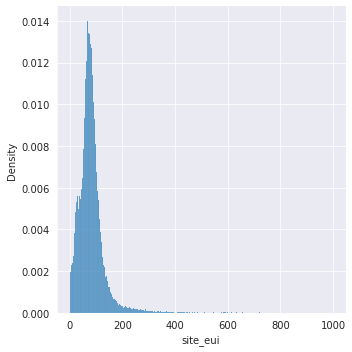

In [ ]:
# Plot the distribution
# Hint https://seaborn.pydata.org/tutorial/distributions.html
sns.displot(x="site_eui", data=df, stat="density")

Explore predictors

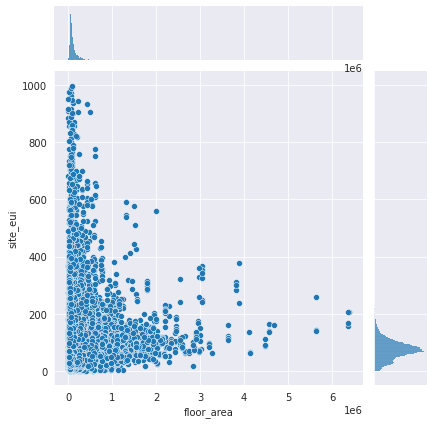

In [ ]:
# Scatterplot using seaborn (sns) library
# Hint: https://seaborn.pydata.org/generated/seaborn.jointplot.html
sns.jointplot(data=df, x="floor_area", y="site_eui")

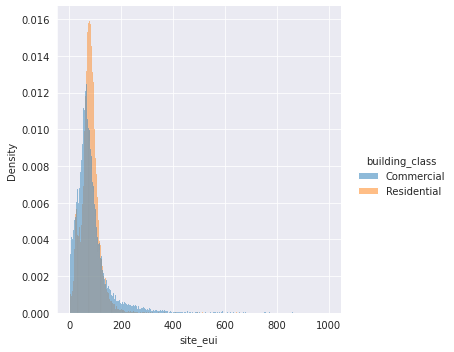

In [ ]:
# Plot the distribution of target variable sliced by different categorical variables.
# Hint https://seaborn.pydata.org/tutorial/distributions.html
# Since the number of observations is very different for Commercial vs Residential buildings, the counts for each subset is normalized independently (e.g. stat="density", common_norm=False)
sns.displot(x="site_eui", data=df, hue = "building_class", stat="density", common_norm=False)

In [ ]:
#Check variables "year_built", "energy_star_rating" for all Categorical Values + Year_Factor

list_to_group_by = ['State_Factor', 'building_class', 'facility_type', 'year_built', 'energy_star_rating']

#col_group = dict(Min='min', sum='Sum', mean='Mean', std='Std')
#rnm_cols = dict(size='Size', sum='Sum', mean='Mean', std='Std')
#df.set_index(['Category', 'Item']).stack().groupby('Category') \
#  .agg(rnm_cols.keys()).rename(columns=rnm_cols)

for i in list_to_group_by:
    data_grouped = df.groupby(i).agg(
        min_year_built=pd.NamedAgg(column = "year_built", aggfunc = min), 
        max_year_built=pd.NamedAgg(column = "year_built", aggfunc = max),
        mean_year_built=pd.NamedAgg(column = "year_built", aggfunc = np.mean),  
        median_year_built=pd.NamedAgg(column = "year_built", aggfunc = np.median), 
        
        
        min_energy_star_rating=pd.NamedAgg(column = "energy_star_rating", aggfunc = min),
        max_energy_star_rating=pd.NamedAgg(column = "energy_star_rating", aggfunc = max), 
        mean_energy_star_rating=pd.NamedAgg(column = "energy_star_rating", aggfunc = np.mean),  
        median_energy_star_rating=pd.NamedAgg(column = "energy_star_rating", aggfunc = np.median), 
        
        
        )
    
    print(data_grouped)

#df = df.drop("new_play_count"], axis=1)

              min_year_built  max_year_built  mean_year_built  \
State_Factor                                                    
State_1                  0.0          2010.0      1938.277485   
State_10              1957.0          1990.0      1970.800000   
State_11              1900.0          2015.0      1968.841966   
State_2               1789.0          2015.0      1968.620067   
State_4               1860.0          2015.0      1961.821445   
State_6               1600.0          2015.0      1948.763073   
State_8               1732.0          2015.0      1957.419486   

              median_year_built  min_energy_star_rating  \
State_Factor                                              
State_1                  1927.0                     0.0   
State_10                 1969.0                    74.0   
State_11                 1975.0                     1.0   
State_2                  1970.0                     1.0   
State_4                  1969.0                     1.0   
S

In [ ]:
# Explore correlations between numerical features and the target variable
# Select only numerical (float) features
num_features = df.select_dtypes(include=['float64', 'int64']).columns.values
# Compute correlations between all numerical features
df_corr = df[num_features].corr()
df_corr

,Year_Factor,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,...,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui
Year_Factor,1.000000,-0.036363,0.084143,-0.005052,0.132855,0.007913,-0.099628,-0.291137,-0.391312,-0.101799,...,0.209500,0.185233,0.054718,-0.043701,-0.013635,0.231525,0.214651,0.233857,0.619227,-0.045179
floor_area,-0.036363,1.000000,0.100878,0.034947,0.097797,-0.148467,-0.137654,-0.104118,-0.106110,-0.120068,...,0.140324,0.049897,0.022583,-0.031415,-0.009205,-0.000018,-0.003984,-0.000922,0.014282,0.073967
year_built,0.084143,0.100878,1.000000,-0.073857,0.047803,-0.011210,-0.032846,-0.080230,-0.000619,-0.020201,...,0.053247,-0.035519,-0.005065,-0.054164,NaN,0.001168,-0.009591,0.004945,0.084167,0.017162
energy_star_rating,-0.005052,0.034947,-0.073857,1.000000,-0.016783,0.144452,0.149421,0.081703,0.126411,0.137479,...,-0.019048,-0.074993,0.019541,0.059382,NaN,-0.000992,0.002014,-0.000333,0.019387,-0.511012
ELEVATION,0.132855,0.097797,0.047803,-0.016783,1.000000,-0.255502,-0.233452,-0.345130,-0.153185,-0.184543,...,0.618740,0.062014,0.184423,0.104934,0.077188,0.050804,0.074144,0.040172,0.495345,0.011798
january_min_temp,0.007913,-0.148467,-0.011210,0.144452,-0.255502,1.000000,0.971149,0.658252,0.812591,0.857222,...,-0.449830,-0.497106,-0.038401,0.200292,0.034708,-0.159144,-0.159938,-0.162500,-0.035741,-0.179190
january_avg_temp,-0.099628,-0.137654,-0.032846,0.149421,-0.233452,0.971149,1.000000,0.754602,0.830236,0.911228,...,-0.417367,-0.462088,0.049163,0.256483,0.048114,-0.267947,-0.257252,-0.271260,-0.108595,-0.167982
january_max_temp,-0.291137,-0.104118,-0.080230,0.081703,-0.345130,0.658252,0.754602,1.000000,0.627150,0.718547,...,-0.547716,-0.114064,0.217033,0.323637,0.057500,-0.298733,-0.281605,-0.302567,-0.321699,-0.097070
february_min_temp,-0.391312,-0.106110,-0.000619,0.126411,-0.153185,0.812591,0.830236,0.627150,1.000000,0.803705,...,-0.403062,-0.627310,-0.076186,0.205320,0.029134,-0.345252,-0.328404,-0.349035,-0.286155,-0.147348
february_avg_temp,-0.101799,-0.120068,-0.020201,0.137479,-0.184543,0.857222,0.911228,0.718547,0.803705,1.000000,...,-0.393891,-0.470964,0.116649,0.249123,0.041692,-0.695722,-0.679818,-0.694419,-0.173583,-0.154071


In [ ]:
# Sort features by their (absolute) correlation with the target variable.
# Here we see that "energy_star_rating" is highly correlated with site_eui (our target), so it might be a good predictor.
df_corr.sort_values(by='site_eui', key=abs, ascending=False)['site_eui']

site_eui                     1.000000
energy_star_rating          -0.511012
january_min_temp            -0.179190
january_avg_temp            -0.167982
snowfall_inches              0.157284
february_avg_temp           -0.154071
heating_degree_days          0.147861
february_min_temp           -0.147348
days_below_30F               0.139811
march_avg_temp              -0.135303
march_min_temp              -0.134110
july_avg_temp                0.133856
cooling_degree_days          0.125004
june_avg_temp                0.122019
days_below_20F               0.119492
august_avg_temp              0.113786
precipitation_inches         0.113558
snowdepth_inches             0.113371
april_avg_temp              -0.113008
april_min_temp              -0.111528
september_avg_temp           0.108853
july_min_temp                0.108092
february_max_temp           -0.106693
november_min_temp           -0.100349
september_max_temp           0.098326
january_max_temp            -0.097070
october_min_

In [ ]:
# Sort features by their (absolute) correlation with the target variable.
# Here we see that "energy_star_rating" is highly correlated with site_eui (our target), so it might be a good predictor.
df_corr.sort_values(by='energy_star_rating', key=abs, ascending=False)['energy_star_rating']

energy_star_rating           1.000000
site_eui                    -0.511012
january_avg_temp             0.149421
january_min_temp             0.144452
snowfall_inches             -0.140722
february_avg_temp            0.137479
march_avg_temp               0.137160
march_min_temp               0.134648
heating_degree_days         -0.133304
days_below_30F              -0.132442
february_min_temp            0.126411
days_below_20F              -0.113404
snowdepth_inches            -0.111075
precipitation_inches        -0.109899
july_avg_temp               -0.107087
june_avg_temp               -0.106010
april_min_temp               0.105996
february_max_temp            0.104399
april_max_temp               0.101430
april_avg_temp               0.100951
cooling_degree_days         -0.098710
november_min_temp            0.096028
july_min_temp               -0.093468
august_avg_temp             -0.093280
september_avg_temp          -0.087785
avg_temp                     0.086425
january_max_

<AxesSubplot:>

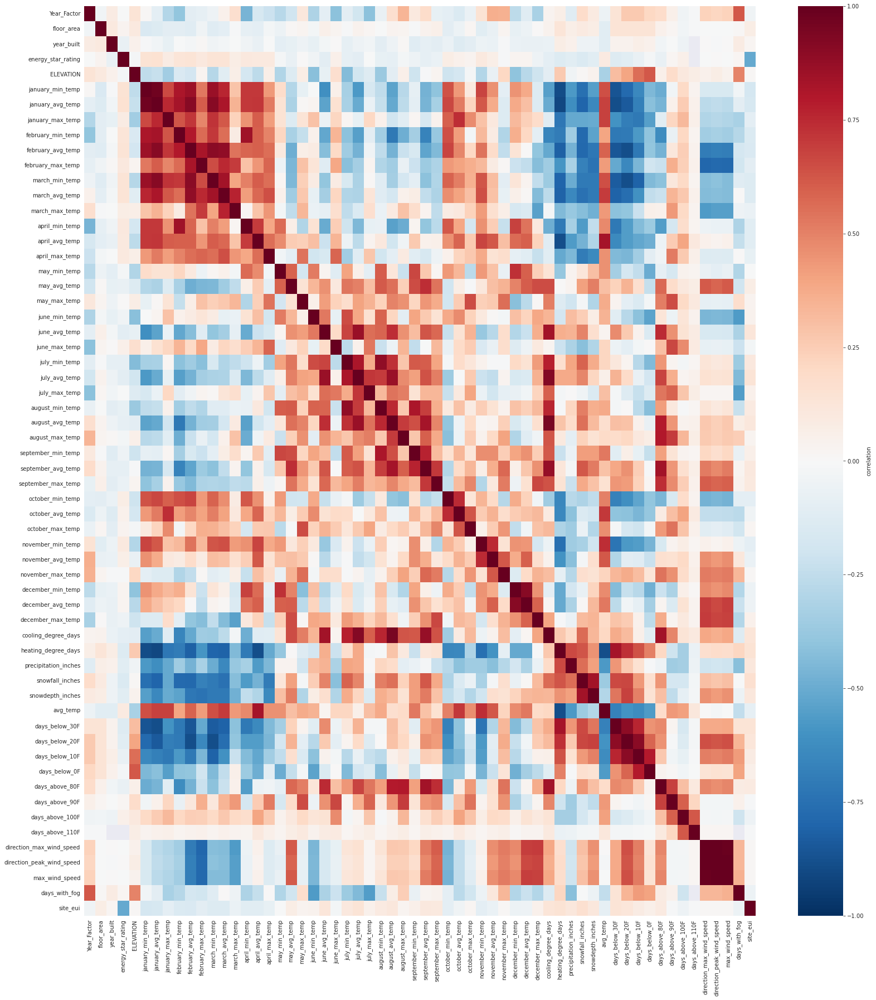

In [ ]:
# Plot correlations as a heatmap
# Here we notice that direction_max_wind_speed, direction_peak_wind_speed, and max_wind_speed are highly correlated with each other.
# This could indicate that we can drop some of these features.
fig, ax = plt.subplots(figsize=(27, 30))
sns.heatmap(df_corr, vmin=-1, vmax=1, cmap = 'RdBu_r', xticklabels=True, yticklabels=True, cbar_kws={'label' : 'correlation'}, ax=ax)

In [ ]:
#Features with HIGH CORRELATION

# Sort features by their (absolute) correlation with the target variable.
# Here we see that "energy_star_rating" is highly correlated with site_eui (our target), so it might be a good predictor.
perc_corr = 0.5
for i in num_features:
    print("FEATURE: ", i)
    print(    df_corr.loc[perc_corr <=  abs(df_corr[i])].sort_values(by=i, key=abs, ascending=False)[i].loc[ abs(df_corr[i]) < 1]  )

FEATURE:  Year_Factor
days_with_fog    0.619227
Name: Year_Factor, dtype: float64
FEATURE:  floor_area
Series([], Name: floor_area, dtype: float64)
FEATURE:  year_built
Series([], Name: year_built, dtype: float64)
FEATURE:  energy_star_rating
site_eui   -0.511012
Name: energy_star_rating, dtype: float64
FEATURE:  ELEVATION
days_below_0F     0.618740
days_below_10F    0.561204
Name: ELEVATION, dtype: float64
FEATURE:  january_min_temp
january_avg_temp        0.971149
heating_degree_days    -0.890905
days_below_30F         -0.863560
march_min_temp          0.863239
february_avg_temp       0.857222
february_min_temp       0.812591
days_below_20F         -0.775875
march_avg_temp          0.757879
snowfall_inches        -0.754442
april_min_temp          0.706781
april_avg_temp          0.705547
november_min_temp       0.678309
january_max_temp        0.658252
days_below_10F         -0.646992
avg_temp                0.644480
october_min_temp        0.634664
june_avg_temp          -0.614658
p

In [ ]:
#Features with LOW CORRELATION (collineaer)

# Sort features by their (absolute) correlation with the target variable.
# Here we see that "energy_star_rating" is highly correlated with site_eui (our target), so it might be a good predictor.
perc_corr_l = 0.05
for i in num_features:
    print("FEATURE: ", i)
    print(    df_corr.loc[perc_corr_l >=  abs(df_corr[i])].sort_values(by=i, key=abs, ascending=False)[i] )

FEATURE:  Year_Factor
site_eui              -0.045179
days_above_100F       -0.043701
floor_area            -0.036363
cooling_degree_days    0.032302
days_above_110F       -0.013635
january_min_temp       0.007913
energy_star_rating    -0.005052
Name: Year_Factor, dtype: float64
FEATURE:  floor_area
days_above_80F               0.049897
september_avg_temp           0.046048
cooling_degree_days          0.045823
february_max_temp           -0.042102
july_avg_temp                0.039562
august_avg_temp              0.038335
Year_Factor                 -0.036363
energy_star_rating           0.034947
days_above_100F             -0.031415
april_max_temp              -0.030368
may_max_temp                 0.028982
november_max_temp            0.026904
june_max_temp                0.026853
august_max_temp              0.023841
june_min_temp               -0.023443
days_above_90F               0.022583
july_max_temp                0.021832
october_max_temp             0.020746
days_with_fog  

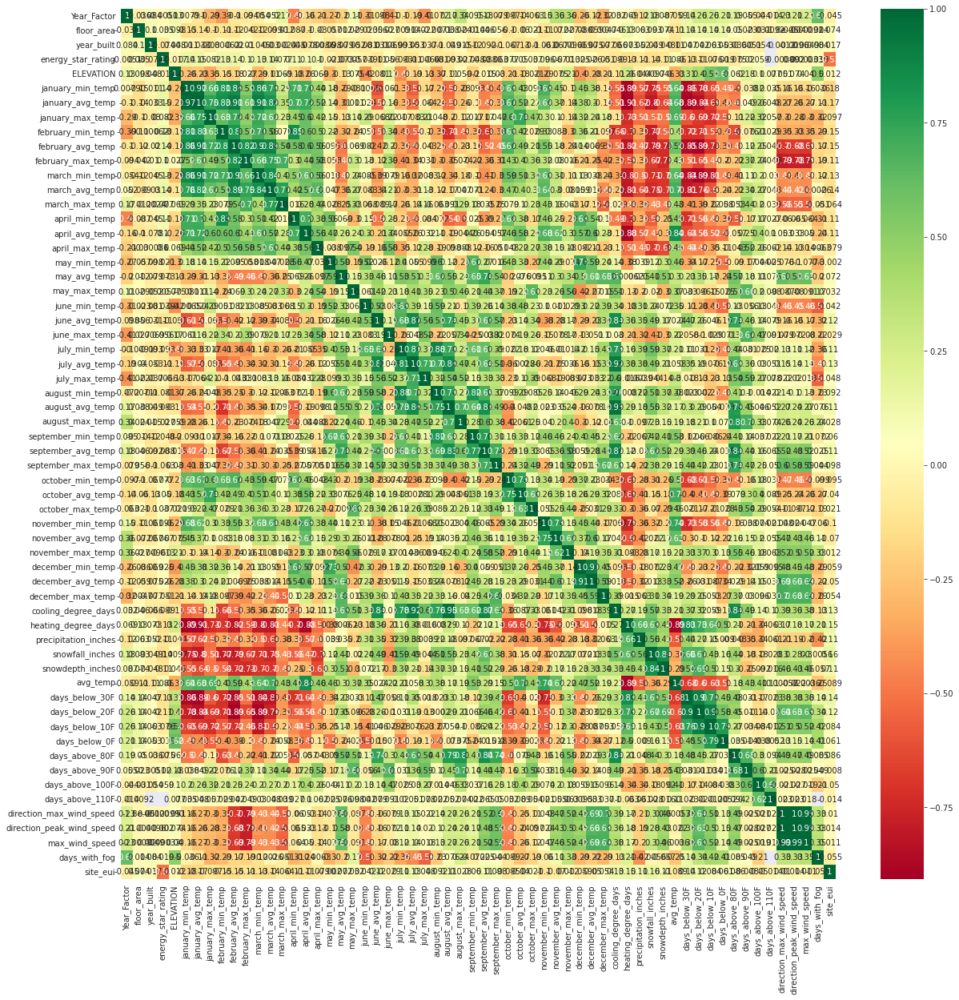

In [ ]:
corrmap = df.corr()
top_corr_features = corrmap.index
plt.figure(figsize=(20,20))
#making a heatmap
train_heatmap = sns.heatmap(df[top_corr_features].corr(), annot = True, cmap = "RdYlGn")

# Pre-process the data
* Feature selection
* One-hot encoding for categorical predictors
* Scale the values of the predictors
* Impute missingness

## Feature selection and engineering
* Create new features and remove irrelevant features
* Irrelevant features can include those that are irrelevant based on prior knowledge
* Irrelevant features can be those that do not vary across the dataset
* Features can be removed if they contain too many missing values or if they are collinear with others

In [ ]:
# Create any new features - e.g. the difference in average temperature in January (typically coldest) vs. July (typically hottest).
#df['january_vs_july_avg_temp_diff'] = df['january_avg_temp'] - df['july_avg_temp']

In [ ]:
# Inspect your DataFrame, are there any covariates that are irrelevant for prediction? Drop unimportant covariates.
# From our correlation analysis above, we notice that direction_max_wind_speed and direction_peak_wind_speed are highly correlated.
# From their names, it also looks like they measure the same thing, so we can drop one of them.

#list of unimportant columns

#days_with_fog                0.019387
#direction_peak_wind_speed    0.013589
#max_wind_speed               0.010639
#direction_max_wind_speed     0.010217

#also we have missing values for year_built, energy_star_rating


df = df.drop(['direction_peak_wind_speed', 'max_wind_speed', 'direction_max_wind_speed', 'days_with_fog'], axis=1)
df_test = df_test.drop(['direction_peak_wind_speed', 'max_wind_speed', 'direction_max_wind_speed', 'days_with_fog'], axis=1)

## One-hot encode categorical variables
Many quantitative models only accept numerical inputs, so it is typical to convert categorical features to numerical features
* Option 1: Represent categorical features as ordinal values (0 to num_categories-1)
* Option 2: Represent categorical features as binary vectors
<img src="table.png" style="height: 300px;" align="center"/>

In [ ]:
from sklearn import preprocessing

le = preprocessing.LabelEncoder()

for i in categorical_features:
    df[i] = le.fit_transform(df[i])
    df_test[i] = le.fit_transform(df_test[i])

In [ ]:
# 2d variant
#df = pd.get_dummies(df)

In [ ]:
# Inspect the encoded data
df_test.head()

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,...,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F
id,,,,,,,,,,,,,,,,,,,,,
75757,7,0,0,13,28484.0,1994.0,37.0,2.4,38,50.596774,...,0,59.894521,0,0,0,0,29,5,2,0
75758,7,0,0,13,21906.0,1961.0,55.0,45.7,38,50.596774,...,0,59.894521,0,0,0,0,29,5,2,0
75759,7,0,0,13,16138.0,1950.0,1.0,59.1,38,50.596774,...,0,59.894521,0,0,0,0,29,5,2,0
75760,7,0,0,13,97422.0,1971.0,34.0,35.4,38,50.596774,...,0,59.894521,0,0,0,0,29,5,2,0
75761,7,0,0,13,61242.0,1942.0,35.0,1.8,38,50.596774,...,0,59.894521,0,0,0,0,29,5,2,0


## Scale the data
* Many models are sensitive to the ranges of features, i.e. features with greater variability by default have greater influence over the outcome
* Option 1: rescale range of data to [0,1]
* Option 2: normalize data to have zero-mean and unit-variance
<img src="rescaling.png" style="height: 300px;" align="center"/>

In [ ]:
'''# Step 1: define a MinMax scalar that will transform the data values into values in (0, 1)
scalar = MinMaxScaler()

# Step 2: fit the MinMaxScaler using our data 
values = df.values
scalar.fit(values)

# Step 3: scale the values in our dataset
values_scaled = scalar.transform(values)
df = pd.DataFrame(values_scaled, columns=df.columns, index=df.index)

#ADD SCALING TEST DATA"""

scaler = MinMaxScaler()
df = scaler.fit_transform(df)
df_test = scaler.transform(df_test)'''

'# Step 1: define a MinMax scalar that will transform the data values into values in (0, 1)\n# Hint: Look up the documentation for MinMaxScaler\nscalar = MinMaxScaler()\n\n# Step 2: fit the MinMaxScaler using our data \n# Hint: use .fit()\nvalues = df.values\nscalar.fit(values)\n\n# Step 3: scale the values in our dataset\n# Hint: use .transform()\nvalues_scaled = scalar.transform(values)\ndf = pd.DataFrame(values_scaled, columns=df.columns, index=df.index)\n\n#ADD SCALING TEST DATA"""\n\nscaler = MinMaxScaler()\ndf = scaler.fit_transform(df)\ndf_test = scaler.transform(df_test)'

## Impute missing values
* Impute (complete) missing values using e.g. scikit-learn (https://scikit-learn.org/stable/modules/impute.html)
* Imputation based on mean/median/mode of the variable
* Imputation based on k-nearest neighbors
* Imputation strategy depends on whether features are missing at random

In [ ]:
df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 75757 entries, 0 to 75756
Data columns (total 59 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Year_Factor           75757 non-null  int64  
 1   State_Factor          75757 non-null  int64  
 2   building_class        75757 non-null  int64  
 3   facility_type         75757 non-null  int64  
 4   floor_area            75757 non-null  float64
 5   year_built            73920 non-null  float64
 6   energy_star_rating    49048 non-null  float64
 7   ELEVATION             75757 non-null  float64
 8   january_min_temp      75757 non-null  int64  
 9   january_avg_temp      75757 non-null  float64
 10  january_max_temp      75757 non-null  int64  
 11  february_min_temp     75757 non-null  int64  
 12  february_avg_temp     75757 non-null  float64
 13  february_max_temp     75757 non-null  int64  
 14  march_min_temp        75757 non-null  int64  
 15  march_avg_temp     

In [ ]:
#THIS IS MY VARIANT DATA IMPUTATION (variables year_built, energy_star_rating) - worki only for year_built
#Can use better way for missing values: linear regression or LGBM.

#Replace 0-values win NaN. 
df.loc[df["year_built"] == 0, "year_built"] = np.nan
df.loc[df["energy_star_rating"] == 0, "energy_star_rating"] = np.nan

# Step 1: Year_built imputation - median of the ficility_type group

for i in df.facility_type.unique():
    #df = pd.DataFrame(imputer.fit_transform(df), columns=df.columns, index=df.index)
    df.loc[df['year_built'].isnull(), 'year_built'] = df['facility_type'].map(df.groupby('facility_type')['year_built'].median())
    df_test.loc[df_test['year_built'].isnull(), 'year_built'] = df_test['facility_type'].map(df_test.groupby('facility_type')['year_built'].median())
       

In [ ]:
# Step 2: impute the missing data for "energy_star_rating"
lr = LinearRegression()

# Keep 15 variables with highest correlation with "energy_star_rating"
df1 = df[['site_eui', 'january_avg_temp', 'january_min_temp', 'snowfall_inches',
'february_avg_temp', 
'march_avg_temp', 'march_min_temp', 'heating_degree_days', 'days_below_30F', 'february_min_temp',
'days_below_20F', 'snowdepth_inches', 'precipitation_inches', 'july_avg_temp', 'june_avg_temp',
'facility_type', 'Year_Factor',  'energy_star_rating']]



''' , 'State_Factor', 'building_class','''


df1

,site_eui,january_avg_temp,january_min_temp,snowfall_inches,february_avg_temp,march_avg_temp,march_min_temp,heating_degree_days,days_below_30F,february_min_temp,days_below_20F,snowdepth_inches,precipitation_inches,july_avg_temp,june_avg_temp,facility_type,Year_Factor,energy_star_rating
id,,,,,,,,,,,,,,,,,,
0,248.682615,50.500000,36.0,0.0,50.589286,53.693548,40.0,2960.0,0.0,35.0,0.0,0.0,16.59,62.725806,60.500000,13.0,1.0,11.0
1,26.500150,50.500000,36.0,0.0,50.589286,53.693548,40.0,2960.0,0.0,35.0,0.0,0.0,16.59,62.725806,60.500000,55.0,1.0,45.0
2,24.693619,50.500000,36.0,0.0,50.589286,53.693548,40.0,2960.0,0.0,35.0,0.0,0.0,16.59,62.725806,60.500000,48.0,1.0,97.0
3,48.406926,50.500000,36.0,0.0,50.589286,53.693548,40.0,2960.0,0.0,35.0,0.0,0.0,16.59,62.725806,60.500000,6.0,1.0,46.0
4,3.899395,50.500000,36.0,0.0,50.589286,53.693548,40.0,2960.0,0.0,35.0,0.0,0.0,16.59,62.725806,60.500000,56.0,1.0,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75752,132.918411,43.451613,28.0,1.4,47.672414,49.354839,35.0,3772.0,6.0,34.0,0.0,1.0,45.03,66.951613,63.566667,32.0,6.0,8.0
75753,39.483672,43.451613,28.0,1.4,47.672414,49.354839,35.0,3772.0,6.0,34.0,0.0,1.0,45.03,66.951613,63.566667,1.0,6.0,98.0
75754,48.404398,36.612903,26.0,36.6,41.637931,41.338710,29.0,6218.0,26.0,30.0,2.0,438.0,106.32,58.758065,56.233333,2.0,6.0,67.0


In [ ]:
'''#Divide df1 for train(with non-null "energy_star_rating") and test(null "energy_star_rating")
testdf = df1[df1['energy_star_rating'].isnull()==True]
traindf = df1[df1['energy_star_rating'].isnull()==False]
y = traindf['energy_star_rating']
traindf.drop("energy_star_rating",axis=1,inplace=True)
testdf.head()'''

'#Divide df1 for train(with non-null "energy_star_rating") and test(null "energy_star_rating")\ntestdf = df1[df1[\'energy_star_rating\'].isnull()==True]\ntraindf = df1[df1[\'energy_star_rating\'].isnull()==False]\ny = traindf[\'energy_star_rating\']\ntraindf.drop("energy_star_rating",axis=1,inplace=True)\ntestdf.head()'

In [ ]:
'''lr.fit(traindf,y)
testdf.drop("energy_star_rating",axis=1,inplace=True)
pred = lr.predict(testdf)
testdf['energy_star_rating']= pred
testdf.describe()'''

'lr.fit(traindf,y)\ntestdf.drop("energy_star_rating",axis=1,inplace=True)\npred = lr.predict(testdf)\ntestdf[\'energy_star_rating\']= pred\ntestdf.describe()'

In [ ]:
'''testdf[testdf["energy_star_rating"]<1].count()'''

'testdf[testdf["energy_star_rating"]<1].count()'

In [ ]:
'''col = 'energy_star_rating'
print(col)
print('Skew :',round(testdf[col].skew(),2))
plt.figure(figsize=(15,4))     
plt.subplot(1,2,1)
testdf[col].hist(bins=12) #df[col].hist(figsize=(3,4), bins = 20)
plt.ylabel('count')
plt.subplot(1,2,2)
sns.boxplot(x=col, data = testdf)
plt.show()'''



"col = 'energy_star_rating'\nprint(col)\nprint('Skew :',round(testdf[col].skew(),2))\nplt.figure(figsize=(15,4))     \nplt.subplot(1,2,1)\ntestdf[col].hist(bins=12) #df[col].hist(figsize=(3,4), bins = 20)\nplt.ylabel('count')\nplt.subplot(1,2,2)\nsns.boxplot(x=col, data = testdf)\nplt.show()"

In [ ]:
'''col = "site_eui"
print(col)
print('Skew :',round(df[col].skew(),2))
plt.figure(figsize=(15,4))     
plt.subplot(1,2,1)
df[col].hist(bins=12) #df[col].hist(figsize=(3,4), bins = 20)
plt.ylabel('count')
plt.subplot(1,2,2)
sns.boxplot(x=col, data = df)
plt.show()'''

'col = "site_eui"\nprint(col)\nprint(\'Skew :\',round(df[col].skew(),2))\nplt.figure(figsize=(15,4))     \nplt.subplot(1,2,1)\ndf[col].hist(bins=12) #df[col].hist(figsize=(3,4), bins = 20)\nplt.ylabel(\'count\')\nplt.subplot(1,2,2)\nsns.boxplot(x=col, data = df)\nplt.show()'

In [ ]:
'''traindf.head()'''

'traindf.head()'

In [ ]:
'''traindf['energy_star_rating']=y
traindf'''

"traindf['energy_star_rating']=y\ntraindf"

In [ ]:
'''# Step 2: impute the missing data for "energy_star_rating"
lr = LinearRegression()

# Keep 15 variables with highest correlation with "energy_star_rating"
df1 = df[['site_eui', 'january_avg_temp', 'january_min_temp', 'snowfall_inches', 'february_avg_temp', 
'march_avg_temp', 'march_min_temp', 'heating_degree_days', 'days_below_30F', 'february_min_temp',
'days_below_20F', 'snowdepth_inches', 'precipitation_inches', 'july_avg_temp', 'june_avg_temp', 'energy_star_rating']]

testdf = df1[df1['energy_star_rating'].isnull()==True]
traindf = df1[df1['energy_star_rating'].isnull()==False]
y = traindf['energy_star_rating']
traindf.drop("energy_star_rating",axis=1,inplace=True)

lr.fit(traindf,y)
testdf.drop("energy_star_rating",axis=1,inplace=True)
pred = lr.predict(testdf)
testdf['energy_star_rating']= pred

traindf['energy_star_rating']=y

df['energy_star_rating'] = df1['energy_star_rating']

df.describe()'''

'# Step 2: impute the missing data for "energy_star_rating"\nlr = LinearRegression()\n\n# Keep 15 variables with highest correlation with "energy_star_rating"\ndf1 = df[[\'site_eui\', \'january_avg_temp\', \'january_min_temp\', \'snowfall_inches\', \'february_avg_temp\', \n\'march_avg_temp\', \'march_min_temp\', \'heating_degree_days\', \'days_below_30F\', \'february_min_temp\',\n\'days_below_20F\', \'snowdepth_inches\', \'precipitation_inches\', \'july_avg_temp\', \'june_avg_temp\', \'energy_star_rating\']]\n\ntestdf = df1[df1[\'energy_star_rating\'].isnull()==True]\ntraindf = df1[df1[\'energy_star_rating\'].isnull()==False]\ny = traindf[\'energy_star_rating\']\ntraindf.drop("energy_star_rating",axis=1,inplace=True)\n\nlr.fit(traindf,y)\ntestdf.drop("energy_star_rating",axis=1,inplace=True)\npred = lr.predict(testdf)\ntestdf[\'energy_star_rating\']= pred\n\ntraindf[\'energy_star_rating\']=y\n\ndf[\'energy_star_rating\'] = df1[\'energy_star_rating\']\n\ndf.describe()'

In [ ]:
#THIS IS SIMPLE DATA IMPUTATION
#Can use better way for missing values: linear regression or LGBM.


# Step 1: define a simple imputer, which replaces missing values using the median, using SimpleImputer class
# Hint: look up the documentation for SimpleImputer
imputer = SimpleImputer(strategy = "median")

# Step 2: impute the missing data
df = pd.DataFrame(imputer.fit_transform(df), columns=df.columns, index=df.index)

In [ ]:
def nul_values(col,data):
    null_val = dict()
    for i in col:
        if (data[i].isnull().sum())>0:
            null_val[i] = (data[i].isnull().sum())
    print(null_val)
print("Null values in train data",end=" : ")
nul_values(df.columns,df)
print("Null values in test data",end=" : ")
nul_values(df_test.columns,df_test)

Null values in train data : {}
Null values in test data : {'energy_star_rating': 2254}


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 75757 entries, 0 to 75756
Data columns (total 59 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Year_Factor           75757 non-null  float64
 1   State_Factor          75757 non-null  float64
 2   building_class        75757 non-null  float64
 3   facility_type         75757 non-null  float64
 4   floor_area            75757 non-null  float64
 5   year_built            75757 non-null  float64
 6   energy_star_rating    75757 non-null  float64
 7   ELEVATION             75757 non-null  float64
 8   january_min_temp      75757 non-null  float64
 9   january_avg_temp      75757 non-null  float64
 10  january_max_temp      75757 non-null  float64
 11  february_min_temp     75757 non-null  float64
 12  february_avg_temp     75757 non-null  float64
 13  february_max_temp     75757 non-null  float64
 14  march_min_temp        75757 non-null  float64
 15  march_avg_temp     

In [ ]:
'''# Data Imputation with Linear Regression Model
https://www.analyticsvidhya.com/blog/2021/05/dealing-with-missing-values-in-python-a-complete-guide/#


#Impute Missing and Zero Values for 1."year_built", 2."energy_star_rating"

#Replace 0-values win NaN. 
df.loc[df["year_built"] == 0, "year_built"] = np.nan
df_test.loc[df_test["energy_star_rating"] == 0, "energy_star_rating"] = np.nan 

lr = LinearRegression()
df.head()
testdf = df[df['year_built'].isnull()==True]
traindf = df[df['year_built'].isnull()==False]
y = traindf['year_built']
z = df['energy_star_rating']
traindf.drop(["year_built","energy_star_rating"],axis=1,inplace=True)
lr.fit(traindf,y)
testdf.drop(["year_built","energy_star_rating"],axis=1,inplace=True)
pred = lr.predict(testdf)
testdf['year_built']= pred

traindf['year_built']=y'''

'# Data Imputation with Linear Regression Model\nhttps://www.analyticsvidhya.com/blog/2021/05/dealing-with-missing-values-in-python-a-complete-guide/#\n\n\n#Impute Missing and Zero Values for 1."year_built", 2."energy_star_rating"\n\n#Replace 0-values win NaN. \ndf.loc[df["year_built"] == 0, "year_built"] = np.nan\ndf_test.loc[df_test["energy_star_rating"] == 0, "energy_star_rating"] = np.nan \n\nlr = LinearRegression()\ndf.head()\ntestdf = df[df[\'year_built\'].isnull()==True]\ntraindf = df[df[\'year_built\'].isnull()==False]\ny = traindf[\'year_built\']\nz = df[\'energy_star_rating\']\ntraindf.drop(["year_built","energy_star_rating"],axis=1,inplace=True)\nlr.fit(traindf,y)\ntestdf.drop(["year_built","energy_star_rating"],axis=1,inplace=True)\npred = lr.predict(testdf)\ntestdf[\'year_built\']= pred\n\ntraindf[\'year_built\']=y'

In [ ]:
# Print first couple of rows of the dataset
df.head()

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,...,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,site_eui
id,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.220339,0.009445,0.963772,0.11,0.004557,0.808824,0.735725,...,0.380665,0.0,0.0,0.0,0.0,0.053846,0.0,0.0,0.0,0.248460
1,0.0,0.0,0.0,0.932203,0.042769,0.970223,0.45,0.004247,0.808824,0.735725,...,0.380665,0.0,0.0,0.0,0.0,0.053846,0.0,0.0,0.0,0.025579
2,0.0,0.0,0.0,0.813559,0.043713,0.968238,0.97,0.004247,0.808824,0.735725,...,0.380665,0.0,0.0,0.0,0.0,0.053846,0.0,0.0,0.0,0.023767
3,0.0,0.0,0.0,0.101695,0.008518,0.982630,0.46,0.004247,0.808824,0.735725,...,0.380665,0.0,0.0,0.0,0.0,0.053846,0.0,0.0,0.0,0.047555
4,0.0,0.0,0.0,0.949153,0.010190,0.985112,1.00,0.004557,0.808824,0.735725,...,0.380665,0.0,0.0,0.0,0.0,0.053846,0.0,0.0,0.0,0.002907


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 75757 entries, 0 to 75756
Data columns (total 59 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Year_Factor           75757 non-null  float64
 1   State_Factor          75757 non-null  float64
 2   building_class        75757 non-null  float64
 3   facility_type         75757 non-null  float64
 4   floor_area            75757 non-null  float64
 5   year_built            75757 non-null  float64
 6   energy_star_rating    75757 non-null  float64
 7   ELEVATION             75757 non-null  float64
 8   january_min_temp      75757 non-null  float64
 9   january_avg_temp      75757 non-null  float64
 10  january_max_temp      75757 non-null  float64
 11  february_min_temp     75757 non-null  float64
 12  february_avg_temp     75757 non-null  float64
 13  february_max_temp     75757 non-null  float64
 14  march_min_temp        75757 non-null  float64
 15  march_avg_temp     

In [ ]:
df.describe()

In [ ]:
# Can do PCA for dimension reduction


# Fit a model
* Split into train and test
* Fit model

In [ ]:
# Split into training and test set
predictors = [feature_name for feature_name in df.columns.values if feature_name != 'site_eui']
X_train = df[predictors]
y_train = df['site_eui']
X_test = df_test

In [ ]:
print(X_train.shape)
print(X_test.shape)

In [ ]:
'''# Train linear regression model
reg = LinearRegression().fit(X_train, y_train)
# Score the model - here the best possible score is 1.0.
# Source for how score is computed: https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LinearRegression.html#sklearn.linear_model.LinearRegression.score
# Note that you can compute other metrics to score the model (e.g. root-mean-square deviatio https://en.wikipedia.org/wiki/Root-mean-square_deviation)
print("score of the Linear regresstion model:", reg.score(X_test, y_test))
res = reg.predict(X_test)
res.head()'''


0.1753009508125336

# My Models
* Explore and visualize the data
* Pre-process the data: create or remove new features, feature selection of only important features, etc.
* Fit machine learning models

In [ ]:
# LightGBM is a gradient boosting framework that uses tree based learning algorithms. It is designed to be distributed and efficient with the following advantages:
#Faster training speed and higher efficiency.
#Lower memory usage.
#Better accuracy.
#Support of parallel, distributed, and GPU learning.
#Capable of handling large-scale data.

import lightgbm as ltb
model = ltb.LGBMRegressor(n_estimators=900, learning_rate=0.1,max_depth=450,subsample=0.5)
model.fit(X_train, y_train)
res = model.predict(X_test)
res.head()

In [ ]:
# Random Forest Regression Model

In [ ]:
#Logistic Regression for Continous Variable


In [ ]:


#KNN Regression Model

In [ ]:
# ANN Regression Model

## Making Submission

In [ ]:
sub = pd.read_csv("/kaggle/input/widsdatathon2022/sample_solution.csv")
sub['site_eui'] = res #res = model.predict(df_test)
sub.to_csv("submission.csv", index = False)
sub.head()

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=19d9e1c2-5efe-48a2-893a-3a0d8147ea3c' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>